# Importing the libraries

In [1]:
import pandas as pd
import numpy as np
import pandas_profiling
import seaborn as sns
import matplotlib.pyplot as plt


from featurewiz import featurewiz
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn import tree

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor


from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

Imported version = 0.1.55.
from featurewiz import FeatureWiz
wiz = FeatureWiz(verbose=1)
X_train_selected = wiz.fit_transform(X_train, y_train)
X_test_selected = wiz.transform(X_test)
wiz.features  ### provides a list of selected features ###
                                


# Loading the dataset

In [2]:
crimes_data = pd.read_csv("crime_and_incarceration_by_state.csv")
crimes_data

,jurisdiction,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,FEDERAL,False,2001,149852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ALABAMA,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,NaN,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0
2,ALASKA,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,NaN,514.0,2681.0,23160.0,3847.0,16695.0,2618.0
3,ARIZONA,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,NaN,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0
4,ARKANSAS,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,NaN,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
811,VIRGINIA,False,2016,29882,False,False,8414380.0,18495.0,482.0,NaN,2830.0,4826.0,10357.0,157292.0,20159.0,127285.0,9848.0
812,WASHINGTON,False,2016,17228,False,False,7280934.0,22101.0,195.0,NaN,3133.0,5649.0,13124.0,254994.0,49249.0,173423.0,32322.0
813,WEST VIRGINIA,False,2016,5899,False,False,1828637.0,6633.0,85.0,NaN,684.0,720.0,5144.0,37282.0,9127.0,25657.0,2498.0
814,WISCONSIN,False,2016,23163,False,False,5772917.0,17716.0,232.0,NaN,2005.0,4707.0,10772.0,111911.0,19498.0,82455.0,9958.0


# Descriptive Analysis 

In [3]:
#displaying the number of rows and columns of the dataset
print("Total number of Rows and Columns:",crimes_data.shape)

#displaying the data field values
print("\nColumn Names:\n",crimes_data.columns)

Total number of Rows and Columns: (816, 17)

Column Names:
 Index(['jurisdiction', 'includes_jails', 'year', 'prisoner_count',
       'crime_reporting_change', 'crimes_estimated', 'state_population',
       'violent_crime_total', 'murder_manslaughter', 'rape_legacy',
       'rape_revised', 'robbery', 'agg_assault', 'property_crime_total',
       'burglary', 'larceny', 'vehicle_theft'],
      dtype='object')


In [4]:
#displaying the data types
print("\nData types:\n", crimes_data.dtypes)


Data types:
 jurisdiction               object
includes_jails               bool
year                        int64
prisoner_count              int64
crime_reporting_change     object
crimes_estimated           object
state_population          float64
violent_crime_total       float64
murder_manslaughter       float64
rape_legacy               float64
rape_revised              float64
robbery                   float64
agg_assault               float64
property_crime_total      float64
burglary                  float64
larceny                   float64
vehicle_theft             float64
dtype: object


In [5]:
#information about the dataframe
crimes_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 816 entries, 0 to 815
Data columns (total 17 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   jurisdiction            816 non-null    object 
 1   includes_jails          816 non-null    bool   
 2   year                    816 non-null    int64  
 3   prisoner_count          816 non-null    int64  
 4   crime_reporting_change  799 non-null    object 
 5   crimes_estimated        799 non-null    object 
 6   state_population        799 non-null    float64
 7   violent_crime_total     799 non-null    float64
 8   murder_manslaughter     799 non-null    float64
 9   rape_legacy             749 non-null    float64
 10  rape_revised            199 non-null    float64
 11  robbery                 799 non-null    float64
 12  agg_assault             799 non-null    float64
 13  property_crime_total    799 non-null    float64
 14  burglary                799 non-null    fl

# Statistical Analysis  

In [6]:
#describing the dataset
round(crimes_data.describe(),1)

,year,prisoner_count,state_population,violent_crime_total,murder_manslaughter,rape_legacy,rape_revised,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
count,816.0,816.0,799.0,799.0,799.0,749.0,199.0,799.0,799.0,799.0,799.0,799.0,799.0
mean,2008.5,28606.0,6072322.2,26228.5,313.7,1788.3,2406.2,7696.8,16256.3,187800.6,40870.4,127912.3,19017.9
std,4.6,39556.9,6725499.8,33866.8,386.0,1865.4,2550.5,11107.5,20849.5,213850.3,47829.9,139434.6,30780.4
min,2001.0,1088.0,493754.0,496.0,5.0,99.0,110.0,43.0,270.0,8806.0,1689.0,6660.0,178.0
25%,2004.8,5698.0,1790025.5,5213.0,48.5,571.0,780.0,1106.0,3529.0,47497.5,9406.0,32765.5,4191.0
50%,2008.5,16915.0,4314113.0,15744.0,179.0,1238.0,1723.0,3933.0,10083.0,132773.0,27698.0,95079.0,10583.0
75%,2012.2,30920.5,6808844.5,31843.0,429.0,2092.0,2680.0,8702.0,20308.0,225957.5,47941.0,155688.0,20872.5
max,2016.0,216915.0,39296476.0,212867.0,2503.0,10198.0,13702.0,71142.0,136087.0,1227194.0,250521.0,731486.0,257543.0


# Data Profiling Report

In [119]:
crimesdata_profilereport = crimes_data.profile_report(title='Crimes Data Analysis Report', explorative = True)
crimesdata_profilereport

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [120]:
#saving the profile report 
crimesdata_profilereport.to_file(output_file="Crimes Data Analysis Report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Total Prisoner Count in each state from 2001-2016

In [193]:
crimes_data_group = crimes_data.groupby("jurisdiction")["prisoner_count"].sum()
crimes_data_group

jurisdiction
ALABAMA            412218
ALASKA              82319
ARIZONA            595044
ARKANSAS           216527
CALIFORNIA        2463587
COLORADO           331775
CONNECTICUT        286217
DELAWARE           107258
FEDERAL           3078946
FLORIDA           1485821
GEORGIA            826419
HAWAII              85451
IDAHO              107818
ILLINOIS           733368
INDIANA            404688
IOWA               140107
KANSAS             145769
KENTUCKY           212967
LOUISIANA          307494
MAINE               32566
MARYLAND           360341
MASSACHUSETTS      167613
MICHIGAN           744510
MINNESOTA          140249
MISSISSIPPI        251749
MISSOURI           490801
MONTANA             48071
NEBRASKA            72865
NEVADA             194348
NEW HAMPSHIRE       41605
NEW JERSEY         383572
NEW MEXICO         104630
NEW YORK           945320
NORTH CAROLINA     592037
NORTH DAKOTA        22194
OHIO               785070
OKLAHOMA           384123
OREGON             214227

# Data Cleaning

In [194]:
#checking for null values in the each column of the dataset
for x in range(17):
    print("%-45s %10d" % (crimes_data.columns.values[x], crimes_data.iloc[:,x].isna().sum()))

jurisdiction                                           0
includes_jails                                         0
year                                                   0
prisoner_count                                         0
crime_reporting_change                                17
crimes_estimated                                      17
state_population                                      17
violent_crime_total                                   17
murder_manslaughter                                   17
rape_legacy                                           67
rape_revised                                         617
robbery                                               17
agg_assault                                           17
property_crime_total                                  17
burglary                                              17
larceny                                               17
vehicle_theft                                         17


# Detecting Outliers

Text(0.5, 1.0, 'Count of Prisoners per State')

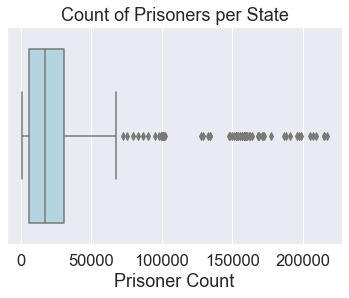

In [195]:
#outliers - boxplot

#prisoner count
sns.boxplot(x = "prisoner_count", data=crimes_data, color="lightblue" )
plt.xlabel("Prisoner Count")
plt.title("Count of Prisoners per State")

Text(0.5, 1.0, 'Count of Violent Crime per State')

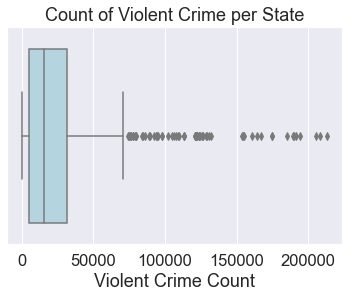

In [196]:
#outliers - boxplot

#violent crime total
sns.boxplot(x = "violent_crime_total", data=crimes_data, color="lightblue" )
plt.xlabel("Violent Crime Count")
plt.title("Count of Violent Crime per State")

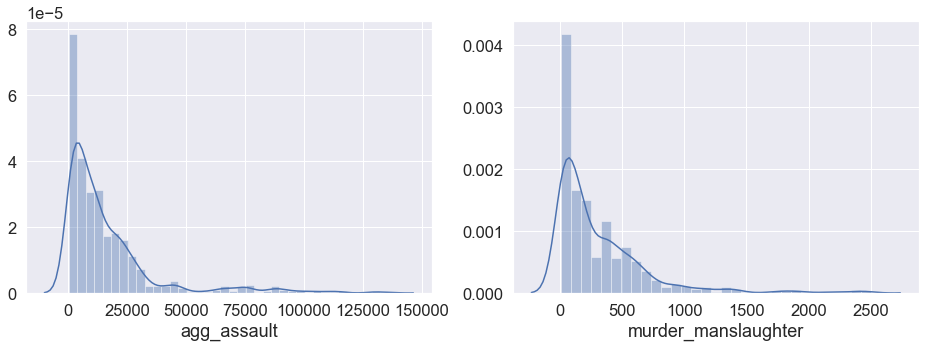

In [197]:
#distribution plot


#plotting distribution for the features
plt.figure(figsize=(16,5))
plt.subplot(1,2,1)
sns.distplot(crimes_data['agg_assault'])
plt.subplot(1,2,2)
sns.distplot(crimes_data['murder_manslaughter'])
plt.show()


# Cleaning Data

In [198]:
#checking for datatype of each variable

crimes_data.dtypes

jurisdiction               object
includes_jails               bool
year                        int64
prisoner_count              int64
crime_reporting_change     object
crimes_estimated           object
state_population          float64
violent_crime_total       float64
murder_manslaughter       float64
rape_legacy               float64
rape_revised              float64
robbery                   float64
agg_assault               float64
property_crime_total      float64
burglary                  float64
larceny                   float64
vehicle_theft             float64
dtype: object

In [199]:
#data cleaning

#dropping rape_revised column as it has maximum null values of the whole data
crimes_data = crimes_data.drop("rape_revised", axis = 1)

In [200]:
crimes_data

,jurisdiction,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft
0,FEDERAL,False,2001,149852,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ALABAMA,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0
2,ALASKA,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,514.0,2681.0,23160.0,3847.0,16695.0,2618.0
3,ARIZONA,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0
4,ARKANSAS,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
811,VIRGINIA,False,2016,29882,False,False,8414380.0,18495.0,482.0,NaN,4826.0,10357.0,157292.0,20159.0,127285.0,9848.0
812,WASHINGTON,False,2016,17228,False,False,7280934.0,22101.0,195.0,NaN,5649.0,13124.0,254994.0,49249.0,173423.0,32322.0
813,WEST VIRGINIA,False,2016,5899,False,False,1828637.0,6633.0,85.0,NaN,720.0,5144.0,37282.0,9127.0,25657.0,2498.0
814,WISCONSIN,False,2016,23163,False,False,5772917.0,17716.0,232.0,NaN,4707.0,10772.0,111911.0,19498.0,82455.0,9958.0


In [201]:
#remaining all row values are null for rows with missing values, hence dropping all those 17 values

crimes_data = crimes_data.dropna(subset=['crime_reporting_change'])
crimes_data.shape

(799, 16)

In [202]:
#checking for null values in the each column of the dataset
for x in range(16):
    print("%-45s %10d" % (crimes_data.columns.values[x], crimes_data.iloc[:,x].isna().sum()))

jurisdiction                                           0
includes_jails                                         0
year                                                   0
prisoner_count                                         0
crime_reporting_change                                 0
crimes_estimated                                       0
state_population                                       0
violent_crime_total                                    0
murder_manslaughter                                    0
rape_legacy                                           50
robbery                                                0
agg_assault                                            0
property_crime_total                                   0
burglary                                               0
larceny                                                0
vehicle_theft                                          0


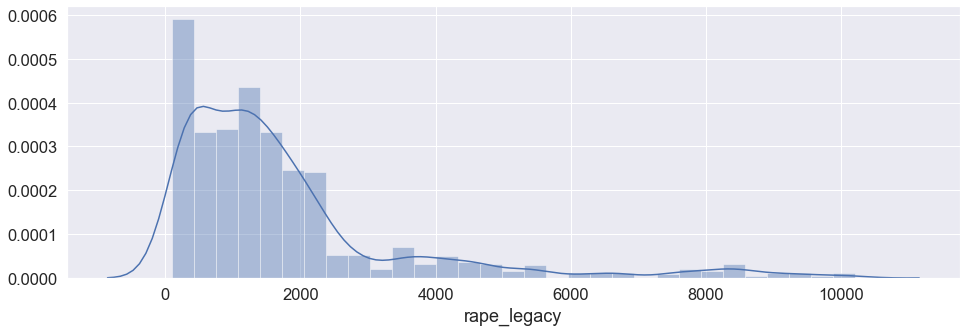

In [203]:
#distribution plot for rape_legacy

plt.figure(figsize=(16,5))
sns.distplot(crimes_data['rape_legacy'])
plt.show()

In [204]:
#input for rape_legacy fied value

#missing data - approx 20%
#data is skewed
#input missing values with median


crimes_data['rape_legacy'] = crimes_data['rape_legacy'].fillna(crimes_data['rape_legacy'].median())
print("Imputed Values!")

Imputed Values!


In [205]:
#checking for null values in the each column of the dataset
for x in range(16):
    print("%-45s %10d" % (crimes_data.columns.values[x], crimes_data.iloc[:,x].isna().sum()))

jurisdiction                                           0
includes_jails                                         0
year                                                   0
prisoner_count                                         0
crime_reporting_change                                 0
crimes_estimated                                       0
state_population                                       0
violent_crime_total                                    0
murder_manslaughter                                    0
rape_legacy                                            0
robbery                                                0
agg_assault                                            0
property_crime_total                                   0
burglary                                               0
larceny                                                0
vehicle_theft                                          0


# Correlation Plot

Text(0.5, 1.0, 'Correlation Plot')

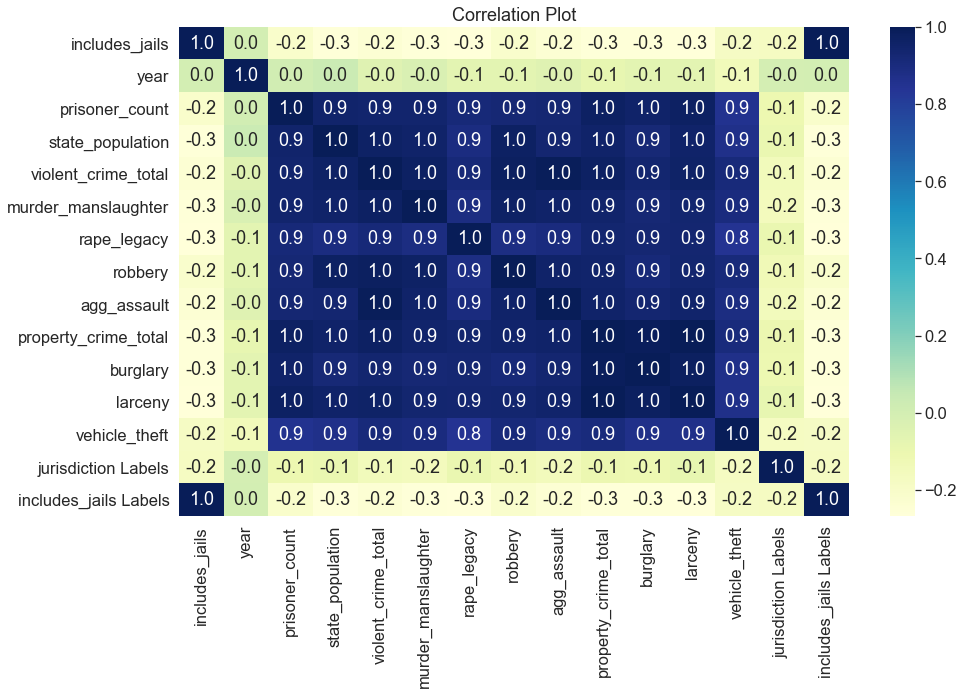

In [237]:
# correlation plot

plt.figure(figsize = (15,9))
ax = plt.subplot()
sns.heatmap(crimes_data.corr(),annot=True, fmt='.1f', ax=ax, cmap="YlGnBu")
ax.set_title('Correlation Plot')

# Feature Selection & Extraction

############################################################################################
############       F A S T   F E A T U R E  E N G G    A N D    S E L E C T I O N ! ########
# Be judicious with featurewiz. Don't use it to create too many un-interpretable features! #
############################################################################################
Skipping feature engineering since no feature_engg input...
Skipping category encoding since no category encoders specified in input...
**INFO: featurewiz can now read feather formatted files. Loading train data...
    Shape of your Data Set loaded: (799, 16)
    Loaded train data. Shape = (799, 16)
No test data filename given...
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data se

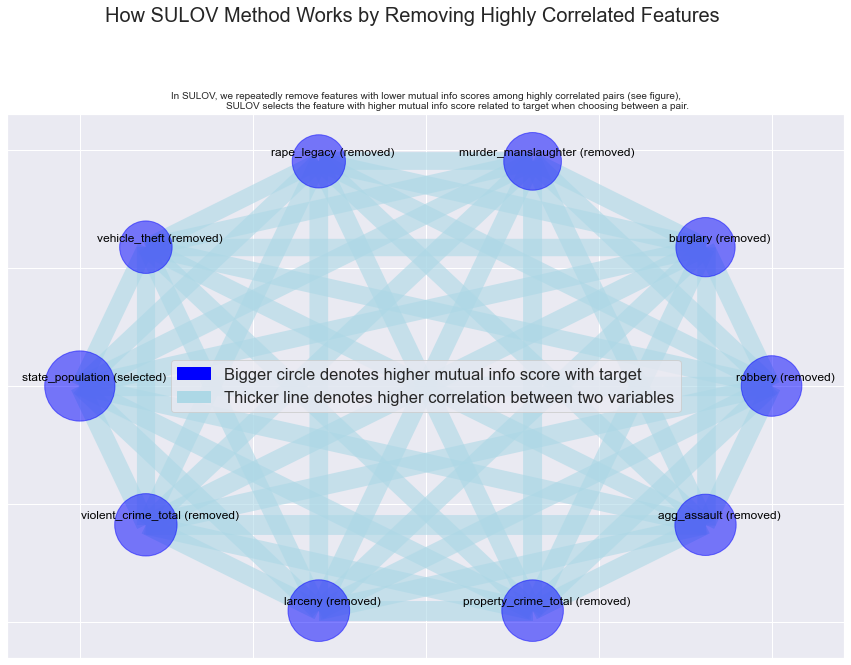

Time taken for SULOV method = 0 seconds
    Adding 4 categorical variables to reduced numeric variables  of 1
Final list of selected vars after SULOV = 5
Readying dataset for Recursive XGBoost by converting all features to numeric...
    there were no mixed data types or object columns that errored. Data is all numeric...
Shape of train data after pruning = (799, 15)
#######################################################################################
#####    R E C U R S I V E   X G B O O S T : F E A T U R E   S E L E C T I O N  #######
#######################################################################################
    using regular XGBoost
Train and Test loaded into Dask dataframes successfully after feature_engg completed
Current number of predictors = 5 
    XGBoost version: 1.6.1
Number of booster rounds = 100
        using 5 variables...
            Time taken for regular XGBoost feature selection = 0 seconds
        using 3 variables...
            Time taken for regul

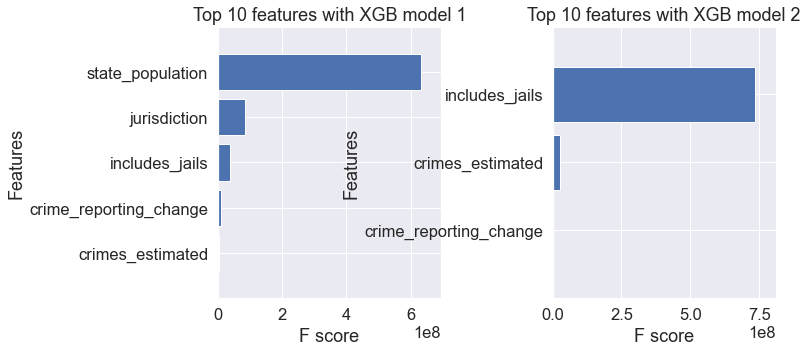

            Total time taken for XGBoost feature selection = 0 seconds
#######################################################################################
#####          F E A T U R E   S E L E C T I O N   C O M P L E T E D            #######
#######################################################################################
Selected 5 important features:
['state_population', 'jurisdiction', 'includes_jails', 'crime_reporting_change', 'crimes_estimated']

    Time taken for feature selection = 1 seconds
Returning 2 dataframes: dataname and test_data with 5 important features.


In [139]:
#automatic feature extraction

target = 'prisoner_count'

features, train = featurewiz(crimes_data, target, corr_limit=0.7, verbose=2, sep=",",
header=0,test_data="", feature_engg="", category_encoders="")

In [140]:
print(features)

['state_population', 'jurisdiction', 'includes_jails', 'crime_reporting_change', 'crimes_estimated']


# Label Encoding

In [207]:
labelencoder = LabelEncoder()
crimes_data['jurisdiction Labels'] = labelencoder.fit_transform(crimes_data["jurisdiction"])
crimes_data['includes_jails Labels'] = labelencoder.fit_transform(crimes_data["includes_jails"])
crimes_data.head(10)

,jurisdiction,includes_jails,year,prisoner_count,crime_reporting_change,crimes_estimated,state_population,violent_crime_total,murder_manslaughter,rape_legacy,robbery,agg_assault,property_crime_total,burglary,larceny,vehicle_theft,jurisdiction Labels,includes_jails Labels
1,ALABAMA,False,2001,24741,False,False,4468912.0,19582.0,379.0,1369.0,5584.0,12250.0,173253.0,40642.0,119992.0,12619.0,0,0
2,ALASKA,True,2001,4570,False,False,633630.0,3735.0,39.0,501.0,514.0,2681.0,23160.0,3847.0,16695.0,2618.0,1,1
3,ARIZONA,False,2001,27710,False,False,5306966.0,28675.0,400.0,1518.0,8868.0,17889.0,293874.0,54821.0,186850.0,52203.0,2,0
4,ARKANSAS,False,2001,11489,False,False,2694698.0,12190.0,148.0,892.0,2181.0,8969.0,99106.0,22196.0,69590.0,7320.0,3,0
5,CALIFORNIA,False,2001,157142,False,False,34600463.0,212867.0,2206.0,9960.0,64614.0,136087.0,1134189.0,232273.0,697739.0,204177.0,4,0
6,COLORADO,False,2001,17278,False,False,4430989.0,15492.0,158.0,1930.0,3555.0,9849.0,170887.0,28533.0,121360.0,20994.0,5,0
7,CONNECTICUT,True,2001,17507,False,False,3434602.0,11492.0,105.0,639.0,4183.0,6565.0,95299.0,17159.0,65762.0,12378.0,6,1
8,DELAWARE,True,2001,6841,False,False,796599.0,4868.0,23.0,420.0,1156.0,3269.0,27399.0,5144.0,19476.0,2779.0,7,1
9,FLORIDA,False,2001,72404,False,False,16373330.0,130713.0,874.0,6641.0,32867.0,90331.0,782517.0,176052.0,516548.0,89917.0,8,0
10,GEORGIA,False,2001,45937,False,False,8405677.0,41671.0,598.0,2180.0,14402.0,24491.0,347872.0,71799.0,238484.0,37589.0,9,0


In [208]:
#new dataframe for training model

new_crimes_data = pd.DataFrame()

new_crimes_data['jurisdiction'] = crimes_data['jurisdiction Labels']
new_crimes_data['includes_jails'] = crimes_data['includes_jails Labels']
new_crimes_data['state_population'] = crimes_data['state_population']
new_crimes_data['violent_crime_total'] = crimes_data['violent_crime_total']
new_crimes_data['murder_manslaughter'] = crimes_data['murder_manslaughter']
new_crimes_data['agg_assault'] = crimes_data['agg_assault']

new_crimes_data.head(10)

,jurisdiction,includes_jails,state_population,violent_crime_total,murder_manslaughter,agg_assault
1,0,0,4468912.0,19582.0,379.0,12250.0
2,1,1,633630.0,3735.0,39.0,2681.0
3,2,0,5306966.0,28675.0,400.0,17889.0
4,3,0,2694698.0,12190.0,148.0,8969.0
5,4,0,34600463.0,212867.0,2206.0,136087.0
6,5,0,4430989.0,15492.0,158.0,9849.0
7,6,1,3434602.0,11492.0,105.0,6565.0
8,7,1,796599.0,4868.0,23.0,3269.0
9,8,0,16373330.0,130713.0,874.0,90331.0
10,9,0,8405677.0,41671.0,598.0,24491.0


In [238]:
new_crimes_data.columns

Index(['jurisdiction', 'includes_jails', 'state_population',
       'violent_crime_total', 'murder_manslaughter', 'agg_assault'],
      dtype='object')

In [209]:
#extracting features and labels from the dataset

x = new_crimes_data
y = crimes_data['prisoner_count']

In [210]:
#splitting data into training and testing set

X_train,X_test,y_train,y_test = train_test_split(x,y,random_state=42, test_size=0.2)
print(X_train.shape)
print(X_test.shape)

(639, 6)
(160, 6)


# Linear Regression Model

In [211]:
#linear regression model

linear_regressionmodel = LinearRegression()
linear_regressionmodel.fit(X_train, y_train)

LinearRegression()

In [212]:
#predict the result for the model

predicted_value_LR = linear_regressionmodel.predict(X_test)

In [267]:
#accuracy of the LR for training and testing set

print('Accuracy of Linear Regressor model on training set: {:.2f}'.format(linear_regressionmodel.score(X_train, y_train)))
print('Accuracy of Linear Regressor model on test set:     {:.2f}'.format(linear_regressionmodel.score(X_test, y_test)))

result_LR = linear_regressionmodel.score(X_test, y_test)
result_LR = round(result_LR,4)
result_LR

Accuracy of Linear Regressor model on training set: 0.92
Accuracy of Linear Regressor model on test set:     0.91


0.9101

# Model Evaluation

In [305]:
#evaluating the model
print("Model Evaluation of Linear Regression.")
print('Mean Absolute Error:', round(metrics.mean_absolute_error(y_test, predicted_value_LR),1))
print('Mean Squared Error:', round(metrics.mean_squared_error(y_test, predicted_value_LR),1))  
print('Root Mean Squared Error:', round(np.sqrt(metrics.mean_squared_error(y_test, predicted_value_LR)),1))
print("R-Squared value:", metrics.r2_score(y_test, predicted_value_LR))

Model Evaluation of Linear Regression.
Mean Absolute Error: 5857.4
Mean Squared Error: 94183008.6
Root Mean Squared Error: 9704.8
R-Squared value: 0.9100756689449834


# Decision Tree Regressor Model

In [280]:
#decision tree regressor

decisiontree_model = DecisionTreeRegressor(max_depth=5)
decisiontree_model.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=5)

In [281]:
#predict the result for the model

predicted_value_dt = decisiontree_model.predict(X_test)

In [282]:
#accuracy of the DT for training and testing set

print('Accuracy of Decision Tree Regressor model on training set: {:.2f}'.format(decisiontree_model.score(X_train, y_train)))
print('Accuracy of Decision Tree Regressor model on test set:     {:.2f}'.format(decisiontree_model.score(X_test, y_test)))

result_DT = decisiontree_model.score(X_test, y_test)
result_DT = round(result_DT,3)
result_DT

Accuracy of Decision Tree Regressor model on training set: 0.99
Accuracy of Decision Tree Regressor model on test set:     0.99


0.986

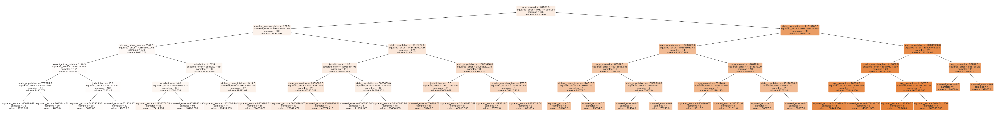

In [285]:
#plotting the decision tree

feature_names = x.columns

plt.figure(figsize=(85,10))
a = tree.plot_tree(decisiontree_model,
                   feature_names = feature_names,
                   class_names = crimes_data['prisoner_count'],
                   rounded = True,
                   filled = True,
                   fontsize=12)
plt.show()

# Feature Importance

<AxesSubplot:>

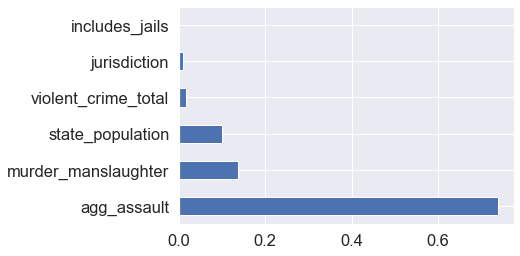

In [286]:
#feature importance for decision tree regressor

(pd.Series(decisiontree_model.feature_importances_, index=x.columns)
   .nlargest(8)
   .plot(kind='barh'))

# Model Evaluation

In [301]:
#evaluating the model
print("Model Evaluation of Decision Tree Regressor.")
print('Mean Absolute Error:', round(metrics.mean_absolute_error(y_test, predicted_value_dt),1))
print('Mean Squared Error:', round(metrics.mean_squared_error(y_test, predicted_value_dt),1))  
print('Root Mean Squared Error:', round(np.sqrt(metrics.mean_squared_error(y_test, predicted_value_dt)),1))
print("R-Squared value:", metrics.r2_score(y_test, predicted_value_dt))

Model Evaluation of Decision Tree Regressor.
Mean Absolute Error: 2371.9
Mean Squared Error: 14738704.8
Root Mean Squared Error: 3839.1
R-Squared value: 0.9859277358751884


# Random Forest Regressor Model

In [293]:
#random forest regressor

randomforest_model = RandomForestRegressor(n_estimators = 5000, max_depth=5)
randomforest_model.fit(X_train, y_train)

RandomForestRegressor(max_depth=5, n_estimators=5000)

In [294]:
#predict the result for the model

predicted_value_rf = randomforest_model.predict(X_test)

In [295]:
#accuracy of the RF for training and testing set

print('Accuracy of Random Forest Regressor model on training set: {:.2f}'.format(randomforest_model.score(X_train, y_train)))
print('Accuracy of Random Forest Regressor model on test set:     {:.2f}'.format(randomforest_model.score(X_test, y_test)))

result_RF = randomforest_model.score(X_test, y_test)
result_RF = round(result_RF,3)
result_RF

Accuracy of Random Forest Regressor model on training set: 0.99
Accuracy of Random Forest Regressor model on test set:     0.99


0.988

# Feature Importance

<AxesSubplot:>

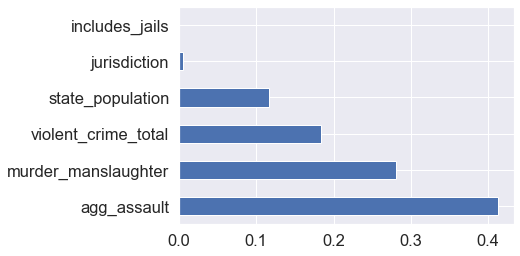

In [296]:
#feature importance for random forest regressor

(pd.Series(randomforest_model.feature_importances_, index=x.columns)
   .nlargest(8)
   .plot(kind='barh'))

# Model Evaluation

In [300]:
#evaluating the model
print("Model Evaluation of Random Forest Regressor.")
print('Mean Absolute Error:', round(metrics.mean_absolute_error(y_test, predicted_value_rf),1))
print('Mean Squared Error:', round(metrics.mean_squared_error(y_test, predicted_value_rf),1))  
print('Root Mean Squared Error:', round(np.sqrt(metrics.mean_squared_error(y_test, predicted_value_rf)),1))
print("R-Squared value:", metrics.r2_score(y_test, predicted_value_rf))

Model Evaluation of Random Forest Regressor.
Mean Absolute Error: 2310.6
Mean Squared Error: 12862887.4
Root Mean Squared Error: 3586.5
R-Squared value: 0.9877187343522992
